# import library

In [154]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import datetime as dt
from statsmodels.tsa.seasonal import seasonal_decompose             # Time series components
from statsmodels.tsa.stattools import adfuller                      # To find the stationarity of the data
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf       # To plot ACF and PACF plots
from statsmodels.tsa.arima.model import ARIMA                       # To build the ARIMA model
from sklearn.metrics import mean_squared_error                      # To check the mean square error                                      
from statsmodels.tsa.statespace.sarimax import SARIMAX              # To build the sarimax model 
import statsmodels.api as sm                                 
import warnings
warnings.filterwarnings('ignore')

In [155]:
beauty=pd.read_csv('beauty_cleandata11.csv')#read data

In [156]:
beauty.head() #top five

,Unnamed: 0,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,reviewTime,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
0,0,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,2015-03-09,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
1,1,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,2015-03-02,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2,2,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,2015-02-19,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
3,3,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,2015-01-14,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
4,4,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,2013-01-13,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [157]:
beauty.drop('Unnamed: 0',axis=1,inplace=True)# drop unnamed column

In [158]:
beauty2 = beauty[["Sentiment","Review"]]
beauty2.groupby('Sentiment').describe()

Review                                  
           count unique                   top freq
Sentiment                                         
Negative    7584   7436  poor qualityone star    4
Neutral    10025   6869         goodfive star  402
Positive   51333  47813      love itfive star  437

In [159]:
beauty.shape

(68943, 17)

In [160]:
beauty.isnull().sum() #check null value

asin            0
title           0
overall         0
brand           0
rank            0
verified        0
reviewerID      0
reviewerName    3
reviewTime      0
price           0
style           0
also_buy        0
also_view       0
main_cat        0
Review          1
polarity        0
Sentiment       0
dtype: int64

In [161]:
beauty.dropna(inplace=True)#drop null value

#### Convert the reviewTime column to a datetime format:

In [162]:
beauty['reviewTime'] = pd.to_datetime(beauty['reviewTime'])

In [163]:
beauty.dtypes#check datatypes

asin                    object
title                   object
overall                  int64
brand                   object
rank                     int64
verified                  bool
reviewerID              object
reviewerName            object
reviewTime      datetime64[ns]
price                  float64
style                   object
also_buy                object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

# Sentiment Forcasting

## sentiment forecasting using time series analysis can provide valuable insights into customer sentiment trends and help businesses make informed decisions to improve customer satisfaction and loyalty.

#### Convert the reviewTime column to a datetime format:

In [164]:
df=beauty.copy()
df.head(5)

,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,reviewTime,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
0,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,2015-03-09,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
1,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,2015-03-02,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,2015-02-19,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
3,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,2015-01-14,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
4,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,2013-01-13,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [12]:
df.dtypes

asin                    object
title                   object
overall                  int64
brand                   object
rank                     int64
verified                  bool
reviewerID              object
reviewerName            object
reviewTime      datetime64[ns]
price                  float64
style                   object
also_buy                object
also_view               object
main_cat                object
Review                  object
polarity               float64
Sentiment               object
dtype: object

In [13]:
df.isnull().sum()

asin            0
title           0
overall         0
brand           0
rank            0
verified        0
reviewerID      0
reviewerName    0
reviewTime      0
price           0
style           0
also_buy        0
also_view       0
main_cat        0
Review          0
polarity        0
Sentiment       0
dtype: int64

In [14]:
# Setting the index as Date
df= df.set_index('reviewTime')
df.head()

,asin,title,overall,brand,rank,verified,reviewerID,reviewerName,price,style,also_buy,also_view,main_cat,Review,polarity,Sentiment
reviewTime,,,,,,,,,,,,,,,,
2015-03-09,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,ASZO5WJA6FVVH,Petra Zender,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,day favorite glad itfive star,0.500000,Positive
2015-03-02,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1KU7EEUGYOJYD,V,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love way perfume smell soft sexy scentfive star,0.366667,Positive
2015-02-19,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A1907XNEJPEZEI,Linda Giambrone,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,love perfume compliment itfive star,0.500000,Positive
2015-01-14,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,True,A3U7B0EKSK16MQ,Kane,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,scent slightly sweet spicy warm definitely uni...,0.244444,Positive
2013-01-13,9790787006,Jenna Jameson Heartbreaker Perfume for women 3...,5,Jenna Jameson,298893,False,A3OCOP75PMY097,Jim Francis,13.85,34 oz,"['B004D8JQ4G', 'B0020MMD0G', 'B00ENL4HJW', 'B0...","['B00357FTX8', 'B01NBID7FJ', 'B0017JT658']",All Beauty,package complete satisfaction wife smell great...,0.227778,Positive


In [15]:
positive=df[(df['Sentiment']=='Positive')]
negative=df[(df['Sentiment']=='Negative')]
neutral=df[(df['Sentiment']=='Neutral')]

In [16]:
pos_df=positive[['polarity']]
pos_df

,polarity
reviewTime,
2015-03-09,0.500000
2015-03-02,0.366667
2015-02-19,0.500000
2015-01-14,0.244444
2013-01-13,0.227778
...,...
2017-05-02,0.155000
2017-01-04,0.600000
2016-12-24,0.400000


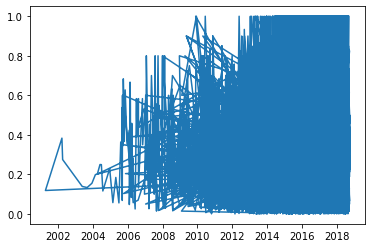

In [17]:
plt.plot(pos_df);

In [18]:
pos_df= pos_df.resample('MS').mean()
pos_df.isnull().sum()

polarity    38
dtype: int64

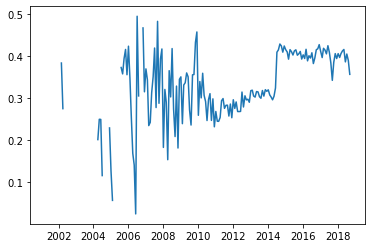

In [19]:
plt.plot(pos_df);

In [20]:
pos_df["polarity"] = pos_df["polarity"].interpolate(option="spline")

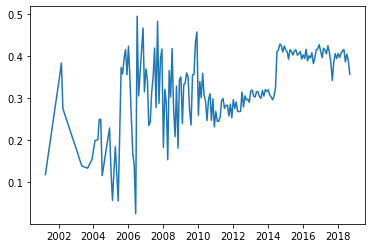

In [21]:
plt.plot(pos_df);

In [22]:
def check_data(data):
    pvalue = adfuller(data)[1]
    print("pvalue",pvalue)
    if pvalue < 0.05:
        msg = "Data is stationary"
    else:
        msg = "Data is not stationary"
    return msg

In [23]:
check_data(pos_df)

pvalue 0.5452025978742161


'Data is not stationary'

In [24]:
for i in range(1,5):
    x = pos_df-pos_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 1.2252052706746059e-05
Shift value 1 Data is stationary


In [25]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((pos_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

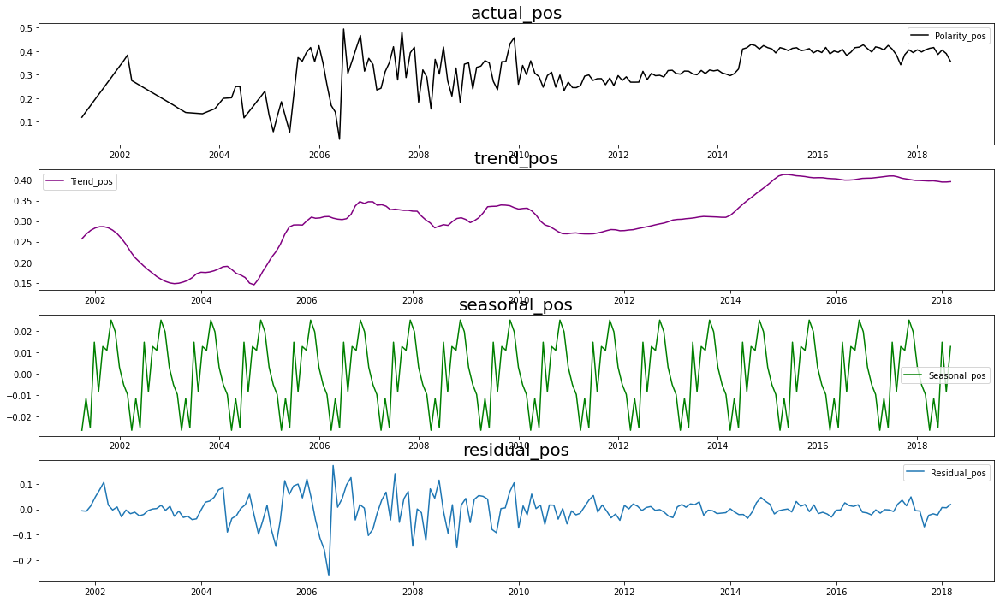

In [26]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(pos_df,label='Polarity_pos',c='black')
plt.legend()
plt.title('actual_pos', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_pos',c='purple')
plt.legend()
plt.title('trend_pos', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_pos',c='green')
plt.legend()
plt.title('seasonal_pos', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_pos')
plt.legend()
plt.title('residual_pos', fontsize = 20)
plt.show()

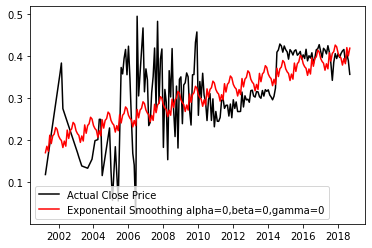

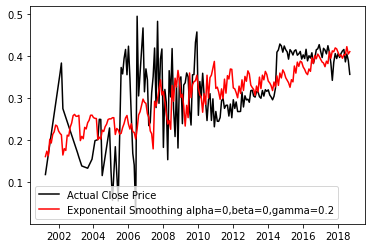

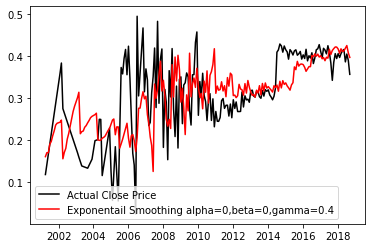

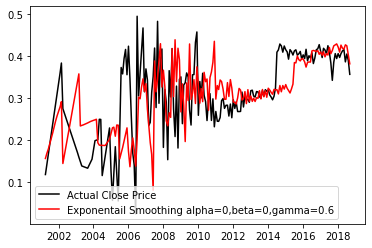

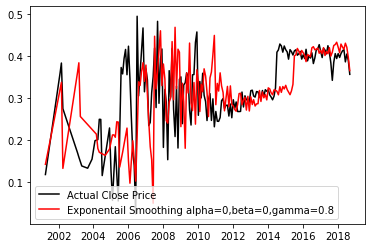

...

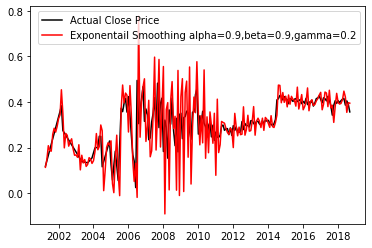

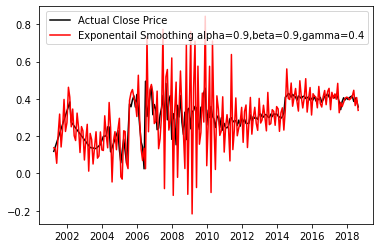

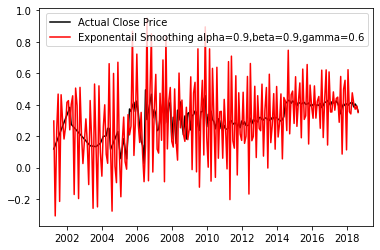

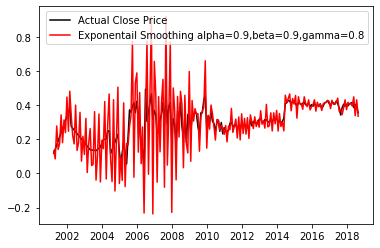

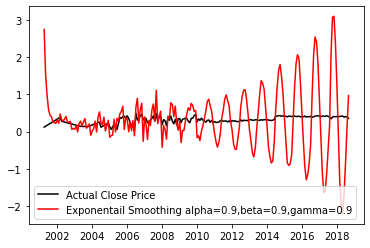

In [27]:
from statsmodels.tsa.api import ExponentialSmoothing
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(pos_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

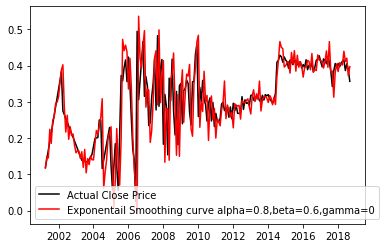

In [28]:
alpha = 0.8
beta = 0.6
gamma = 0
model = ExponentialSmoothing(pos_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(pos_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing curve alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

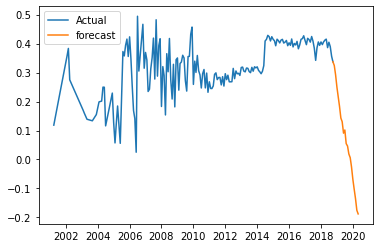

In [29]:
cd = model.forecast(20)
bx = pos_df["polarity"].append(cd[0:1])
plt.plot(bx,label="Actual")
plt.plot(cd,label="forecast")
plt.legend();

In [30]:
check_data(model.fittedvalues)

pvalue 0.5324666488088546


'Data is not stationary'

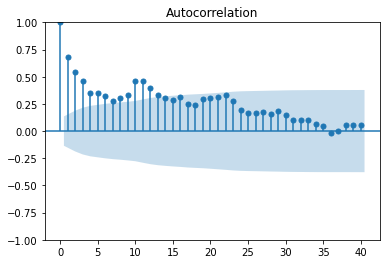

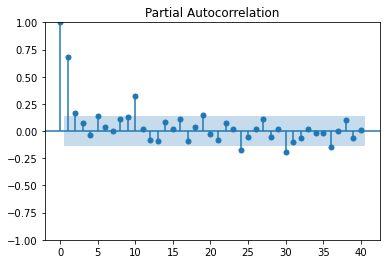

In [31]:
plot_acf(model.fittedvalues,lags=40)
plot_pacf(model.fittedvalues,lags=40);

In [32]:
for p in range(1,12):
    for q in range(1,8):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -478.4299183295492
for  1 2 -477.10676099286127
for  1 3 -475.39153164929456
for  1 4 -477.3594438403421
for  1 5 -475.48825917520435
for  1 6 -475.0788010502204
for  1 7 -472.6158495113451
for  2 1 -477.1741978012877
for  2 2 -474.43240794670197
for  2 3 -473.292977870264
for  2 4 -482.92678060203093
for  2 5 -480.27171471958786
for  2 6 -482.8300729139136
for  2 7 -471.3718454333622
for  3 1 -475.1766887575099
for  3 2 -474.33256032486116
for  3 3 -475.84933069845295
for  3 4 -455.29805516444304
for  3 5 -478.8551201134535
for  3 6 -477.24865651896357
for  3 7 -491.5077003429353
for  4 1 -477.16574005211567
for  4 2 -475.68451645136645
for  4 3 -474.4976126280401
for  4 4 -475.9064466186445
for  4 5 -478.75914371707916
for  4 6 -480.88036912162954
for  4 7 -489.75791407390534
for  5 1 -475.5794367370449
for  5 2 -473.1756618884783
for  5 3 -472.291223172079
for  5 4 -475.45069111848943
for  5 5 -432.8435458998356
for  5 6 -479.21118323846605
for  5 7 -487.4807910270257
for  

In [33]:
rows = int(0.8*len(model.fittedvalues))
pos_train = pos_df[:rows]

pos_test = pos_df[rows:]

In [34]:
pos_mod = sm.tsa.statespace.SARIMAX(pos_train,order=(6,1,3),seasonal_order=(1,1,1,10)).fit()
pp_model = pos_mod.fittedvalues
print(pos_mod.summary())

                                      SARIMAX Results                                       
Dep. Variable:                             polarity   No. Observations:                  168
Model:             SARIMAX(6, 1, 3)x(1, 1, [1], 10)   Log Likelihood                 198.174
Date:                              Mon, 03 Apr 2023   AIC                           -372.349
Time:                                      09:43:08   BIC                           -335.674
Sample:                                  04-01-2001   HQIC                          -357.454
                                       - 03-01-2015                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7805      0.541     -1.444      0.149      -1.840       0.279
ar.L2          0.06

In [35]:
pos_str = len(pos_train)
pos_end = len(pos_train)+(len(pos_test)-1)

In [36]:
pvalue = sm.stats.acorr_ljungbox(pos_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.66017962]
FAILED to Reject H0.Good MODEL


In [37]:
forcast = pos_mod.forecast(60)

In [38]:
pos_pred = pos_mod.predict(pos_str,pos_end)

In [39]:
df_sarima_res_pos = pd.DataFrame({"Predictions":pos_pred})
df_sarima_res_pos["Actual"] = pos_test
df_sarima_res_pos["err"] = df_sarima_res_pos["Actual"]-df_sarima_res_pos["Predictions"]

df_sarima_res_pos

,Predictions,Actual,err
2015-04-01,0.376183,0.415131,0.038947
2015-05-01,0.386807,0.410351,0.023544
2015-06-01,0.375527,0.402348,0.026822
2015-07-01,0.373141,0.412151,0.039010
2015-08-01,0.384641,0.414733,0.030091
2015-09-01,0.400543,0.401892,0.001349
2015-10-01,0.391097,0.405116,0.014019
2015-11-01,0.398553,0.410826,0.012273
2015-12-01,0.381575,0.392729,0.011154
2016-01-01,0.403218,0.402738,-0.000480


In [40]:
pos_pp = pos_train["polarity"].append(pos_pred[0:1])

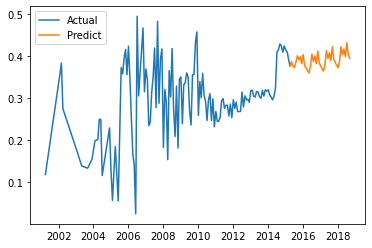

In [41]:
plt.plot(pos_pp,label="Actual")
plt.plot(pos_pred,label="Predict")
plt.legend();

In [42]:
from sklearn.metrics import mean_squared_error
pos_mse = mean_squared_error(pos_pred,pos_test)
print("Positive mse",pos_mse)
print("Positive rmse",np.sqrt(pos_mse))

Positive mse 0.000753469135378302
Positive rmse 0.027449392258815167


# Negative Sentiment Time Series Analysis

In [43]:
neg_df=negative[['polarity']]
neg_df

,polarity
reviewTime,
2017-11-11,-0.233333
2017-01-22,-0.172381
2002-02-26,-0.187500
2018-05-06,-0.125000
2018-05-05,-0.500000
...,...
2018-09-07,-0.063095
2017-07-23,-0.125000
2017-05-14,-0.400000


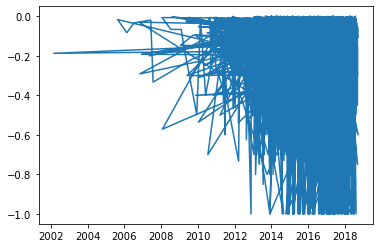

In [44]:
plt.plot(neg_df);

In [45]:
neg_df= neg_df.resample('MS').mean()
neg_df.isnull().sum()

polarity    73
dtype: int64

In [46]:
neg_df["polarity"] = neg_df["polarity"].interpolate(option='spline')
neg_df.isnull().sum()

polarity    0
dtype: int64

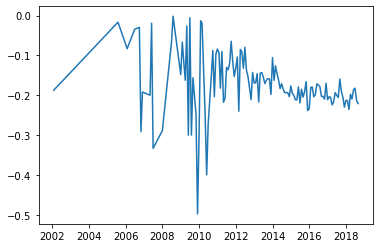

In [47]:
plt.plot(neg_df);

In [48]:
check_data(neg_df)

pvalue 0.08134855376987138


'Data is not stationary'

In [49]:
for i in range(1,5):
    x = neg_df-neg_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 2.023949384856977e-17
Shift value 1 Data is stationary


In [50]:
# Decomposition plot for predicted data using Features
decomposition_p=seasonal_decompose((neg_df), period=12)
trend=decomposition_p.trend
seasonal=decomposition_p.seasonal
residual=decomposition_p.resid

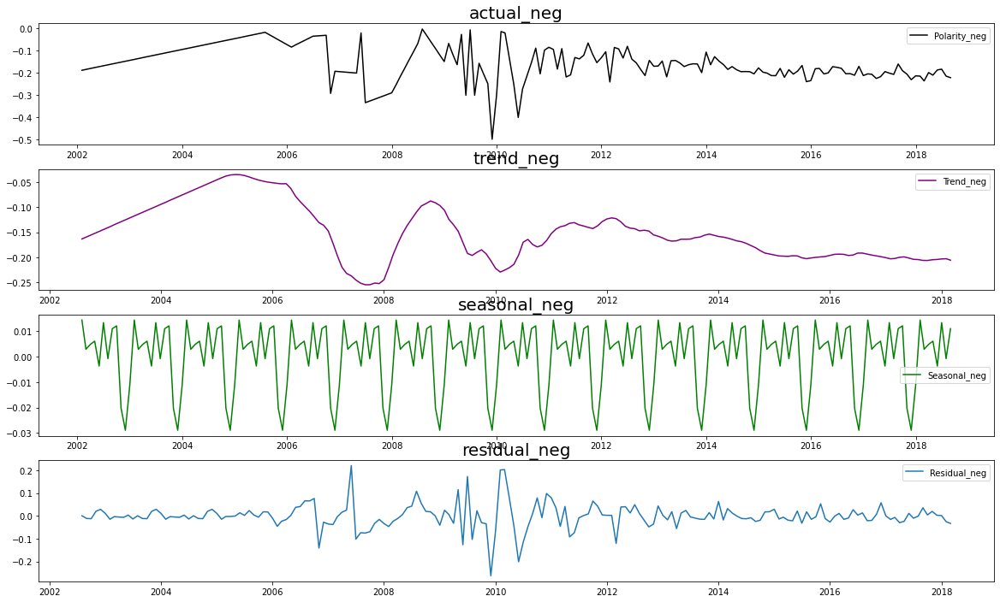

In [51]:
ig,ax = plt.subplots(4,1,figsize=(20,12))

plt.subplot(411)
plt.plot(neg_df,label='Polarity_neg',c='black')
plt.legend()
plt.title('actual_neg', fontsize = 20)

plt.subplot(412)
plt.plot(trend,label='Trend_neg',c='purple')
plt.legend()
plt.title('trend_neg', fontsize = 20)

plt.subplot(413)
plt.plot(seasonal,label='Seasonal_neg',c='green')
plt.legend()
plt.title('seasonal_neg', fontsize = 20)

plt.subplot(414)
plt.plot(residual,label='Residual_neg')
plt.legend()
plt.title('residual_neg', fontsize = 20)
plt.show()

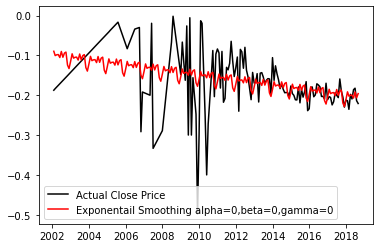

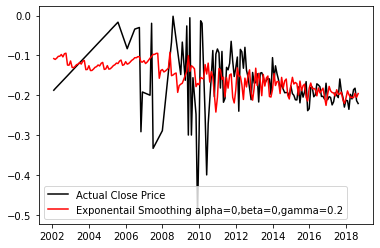

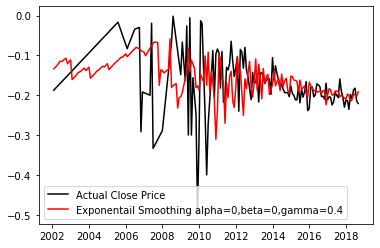

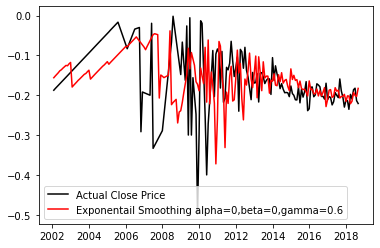

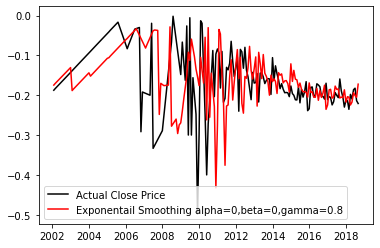

...

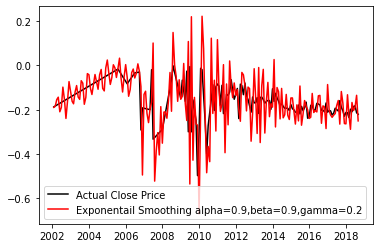

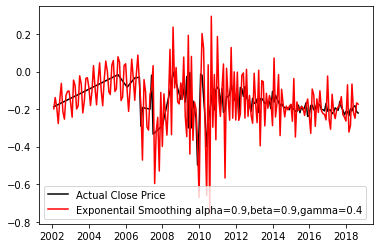

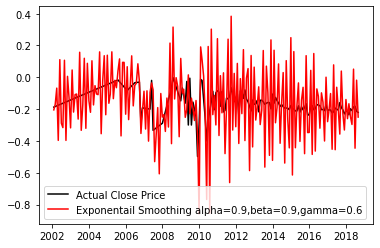

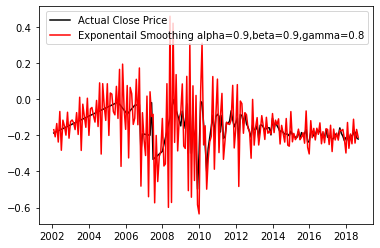

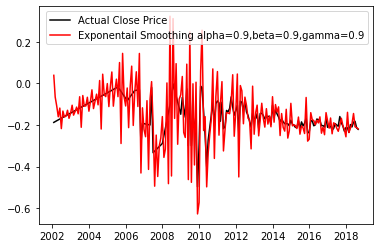

In [52]:
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(neg_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

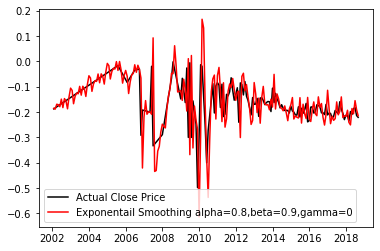

In [53]:
alpha = 0.8
bete = 0.2
gamma = 0
model = ExponentialSmoothing(neg_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(neg_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

In [54]:
sx = model.forecast(60)
dd = neg_df["polarity"].append(sx[0:1])

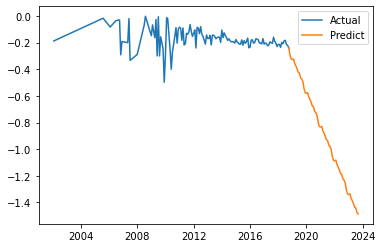

In [55]:
plt.plot(dd,label="Actual")
plt.plot(sx,label="Predict")
plt.legend();

In [56]:
check_data(model.fittedvalues)

pvalue 0.016104621736334965


'Data is stationary'

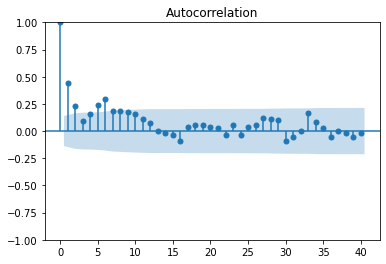

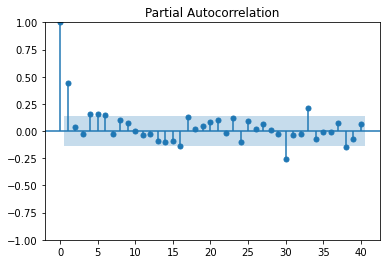

In [57]:
plot_acf(model.fittedvalues,lags=40)
plot_pacf(model.fittedvalues,lags=40);

In [58]:
for q in range(1,7):
    for p in range(1,5):
        mod = sm.tsa.statespace.SARIMAX(model.fittedvalues,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -378.7937554316551
for  2 1 -376.8705168527846
for  3 1 -379.76305895489145
for  4 1 -378.15105838373745
for  1 2 -376.8336181222661
for  2 2 -375.97948924551827
for  3 2 -378.118532439901
for  4 2 -376.1522776826062
for  1 3 -377.01658369376764
for  2 3 -379.14175038641423
for  3 3 -377.1060313672464
for  4 3 -376.94588444884965
for  1 4 -375.59718880674836
for  2 4 -377.24925752099716
for  3 4 -375.3769081283724
for  4 4 -373.4381636501779
for  1 5 -374.5177182121823
for  2 5 -375.18315577043404
for  3 5 -373.7103591777031
for  4 5 -371.9253934318914
for  1 6 -375.7225028147477
for  2 6 -373.97651809952634
for  3 6 -373.0095849258746
for  4 6 -371.03631941124013


In [59]:
n_num = int(0.8*len(model.fittedvalues))
neg_train = neg_df[:n_num]
neg_test = neg_df[n_num:]


In [60]:
negs_mod = sm.tsa.statespace.SARIMAX(neg_train,order=(4,1,5),seasonal_order=(1,1,1,10)).fit()
nn_model = negs_mod.fittedvalues
print(negs_mod.summary())

                                      SARIMAX Results                                       
Dep. Variable:                             polarity   No. Observations:                  160
Model:             SARIMAX(4, 1, 5)x(1, 1, [1], 10)   Log Likelihood                 176.372
Date:                              Mon, 03 Apr 2023   AIC                           -328.743
Time:                                      09:45:28   BIC                           -292.696
Sample:                                  02-01-2002   HQIC                          -314.098
                                       - 05-01-2015                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0928      1.443     -0.757      0.449      -3.921       1.735
ar.L2         -0.84

In [61]:
pvalue = sm.stats.acorr_ljungbox(negs_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.94221514]
FAILED to Reject H0.Good MODEL


In [62]:
nn_str = len(neg_train)
nn_end = len(neg_train)+len(neg_test)-1

In [63]:
ng_pred = negs_mod.forecast(60)

In [64]:
nn_pred = negs_mod.predict(nn_str,nn_end)
nnd = neg_train["polarity"].append(nn_pred[0:1])

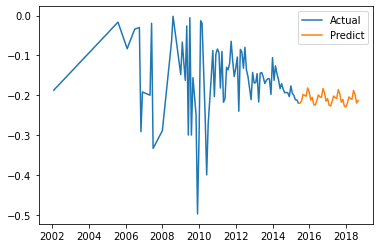

In [65]:
plt.plot(nnd,label="Actual")
plt.plot(nn_pred,label="Predict")
plt.legend();

In [66]:
ndf_sarima_res = pd.DataFrame({"Predictions":nn_pred})
ndf_sarima_res["Actual"] = neg_test
ndf_sarima_res["err"] = ndf_sarima_res["Actual"]-ndf_sarima_res["Predictions"]

ndf_sarima_res

,Predictions,Actual,err
2015-06-01,-0.219677,-0.179145,0.040532
2015-07-01,-0.220329,-0.219140,0.001190
2015-08-01,-0.214598,-0.185106,0.029492
2015-09-01,-0.198191,-0.204734,-0.006544
2015-10-01,-0.200215,-0.191291,0.008923
2015-11-01,-0.202564,-0.165920,0.036644
2015-12-01,-0.181831,-0.238758,-0.056928
2016-01-01,-0.191716,-0.233905,-0.042189
2016-02-01,-0.212376,-0.180451,0.031925
2016-03-01,-0.205300,-0.179273,0.026026


In [67]:
neg_mse = mean_squared_error(nn_pred,neg_test)
print("Negative mse",neg_mse)
print("Negative rmse",np.sqrt(neg_mse))

Negative mse 0.0005819848759054315
Negative rmse 0.02412436270464842


In [68]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.graph_objects as go
from plotly.offline import plot

In [69]:
x = pos_pp.index
y = pos_pp.values
trace1 = go.Scatter(x=x,y=y,name="Pervious Trend of Positive Reviews")
x1 = forcast.index
y1 = forcast.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Trend of Positive Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "All Beauty Review Data",yaxis=dict(title="Polarity score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)

fig.show()


## line chart to visualize the trend of forcasting positive reviews for the "All Beauty" dataset.

In [70]:
x = nnd.index
y = nnd.values
trace1 = go.Scatter(x=x,y=y,name="Pervious trend of Negative Reviews")
x1 = ng_pred.index
y1 = ng_pred.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecasted Future trend of Negative Reviews")

data = [trace1,trace2]
layout = go.Layout(title = "All Beauty",yaxis=dict(title="Polarity Score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)

fig.show()

## line chart to visualize the trend of forcasting negative reviews for the "All Beauty" dataset

In [71]:
plt.savefig('my_graphpos.png')

<Figure size 432x288 with 0 Axes>

In [72]:
plt.savefig('my_graphpos1.pdf', format='pdf')


<Figure size 432x288 with 0 Axes>